In [1]:
# Это нужно, чтоб увидеть NEURON (только для кластера Леона)
import sys
sys.path.append("/home/leon/nrn/build/lib/python")

import os
import json
import pandas as pd

os.chdir("../..")

from scripts.NEURON_Sim_Wrapper import Network
from scripts.Sim_Visializations import *

# # Включаем CoreNEURON
# # coreneuron.enable = True
# # coreneuron.gpu = True
# # coreneuron.verbose = 1
# # coreneuron.num_gpus = 2
# h.nrnmpi_init()
# h.load_file('stdrun.hoc')

# Get 20 Neuron Cluster and Params
The corresponding neuron id's are got from the most strongly connected 20 neuron cluster of the connectome (got from `/Leon/Technical/Get_Strong_Con_Cluster.ipynb`).

Also the Neurite's parameters for the one where optimized by `...` and saved into `...`

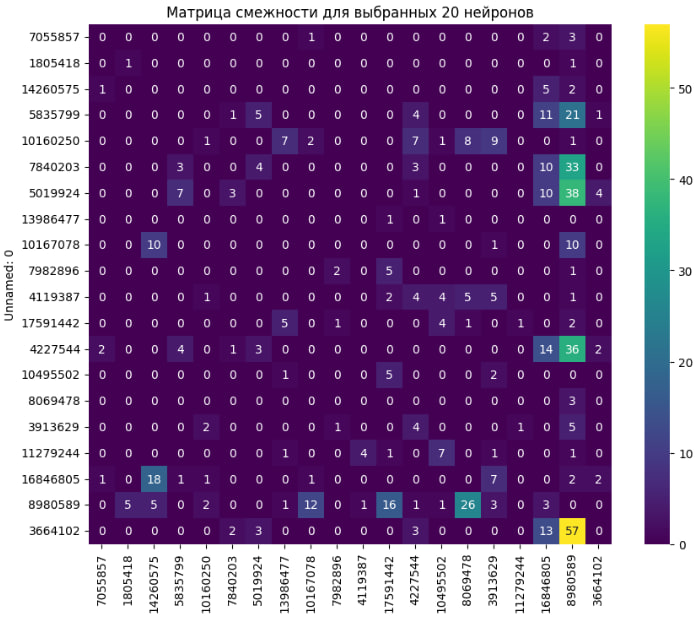

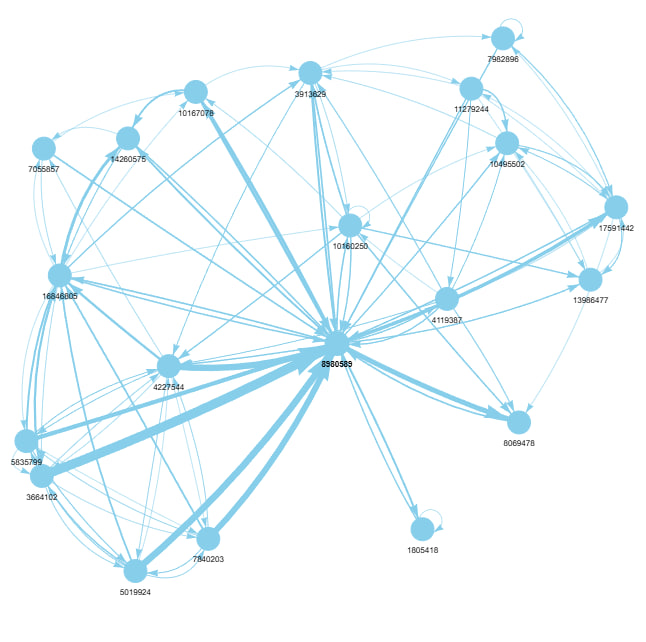
<div style="clear:both;"></div>

Totaly, overall network will have corresponding parameters:

```
soma_params = {
    'L': 20,            # длина
    'diam': 20,         # диаметр
    'Ra': 100,          # аксиальное сопротивление
    'cm': 1,            # емкость мембраны
    
    'gnabar_hh': 0.12,  # проводимость натриевых каналов
    'gkbar_hh': 0.036,  # проводимость калиевых каналов
    'gl_hh': 0.0003,    # утечка (leak) проводимость
    'el_hh': -54.3      # обратный потенциал утечки
}


neurite_params = {
    'L': 5.0,           # µm (длина одного стандартного компартмента)
    'diam': 1.0,        # µm (компромиссный диаметр для аксона/дендрита)
    'Ra': 100.0,        # Ω·cm (типичное значение для членистоногих/общая практика)
    'cm': 1.0,          # µF/cm^2 (станд. мембранная ёмкость)
    

    'gnabar_hh': OPTIMIZED,  # S/cm^2  проводимость натриевых каналов
    'gkbar_hh': OPTIMIZED,   # S/cm^2  проводимость калиевых каналов
    'gl_hh': OPTIMIZED,      # S/cm^2  утечка (leak) проводимость
    'el_hh': -70.0           # mV      обратный потенциал утечки
}


syn_params = {
    'tau1': 0.5,        # время нарастания
    'tau2': 2.0,        # время спада
    'e': 0.0            # обратный потенциал (возбуждающий)
}


netcon_params = {
    'threshold': 0.0,    # порог (мВ) *это просто чтоб показать работоспособность
    'weight': 0.5,       # вес синапса (микросименсы)
    'delay': 3.0         # задержка (мс)
}

```

In [2]:
neuron_list = ['7055857', '1805418', '14260575', '5835799', '10160250', '7840203', '5019924', '13986477', '10167078', '7982896', '4119387', '17591442', '4227544', '10495502', '8069478', '3913629', '11279244', '16846805', '8980589', '3664102']



# Get the neurite params for the ones
with open("./Datasets/Generated/Optimized_Neural_Params(95).json", "r") as f:
    data = json.load(f)

rows = []
for neuron_id, content in data["results"].items():
    p = content["best_params"]
    rows.append({
        "neuron_id": int(neuron_id),
        "gnabar_hh": p["dend_gnabar_hh"],
        "gkbar_hh": p["dend_gkbar_hh"],
        "gl_hh": p["dend_gl_hh"]
    })

neurites_params = pd.DataFrame(rows)

# Cast to string
neurites_params["neuron_id"] = neurites_params["neuron_id"].astype(str)

# Get only needed 20 neurons
neurites_params = neurites_params[neurites_params["neuron_id"].isin(neuron_list)]



# Set the rest of params manually
neurites_params['L'] = 5.0
neurites_params['diam'] = 1.0
neurites_params['Ra'] = 100.0
neurites_params['cm'] = 1.0
neurites_params['el_hh'] = -70.0



neurites_params

,neuron_id,gnabar_hh,gkbar_hh,gl_hh,L,diam,Ra,cm,el_hh
30,13986477,0.034626,0.096299,0.000208,5.0,1.0,100.0,1.0,-70.0
116,7840203,0.039226,0.028295,0.000064,5.0,1.0,100.0,1.0,-70.0
1140,3913629,0.024094,0.007244,0.000280,5.0,1.0,100.0,1.0,-70.0
1284,11279244,0.023055,0.008537,0.000207,5.0,1.0,100.0,1.0,-70.0
1567,5019924,0.043552,0.021271,0.000403,5.0,1.0,100.0,1.0,-70.0
1834,7055857,0.023096,0.006846,0.000138,5.0,1.0,100.0,1.0,-70.0
1837,1805418,0.038354,0.025032,0.000086,5.0,1.0,100.0,1.0,-70.0
1912,17591442,0.023632,0.008660,0.000159,5.0,1.0,100.0,1.0,-70.0
2047,16846805,0.092362,0.013281,0.000939,5.0,1.0,100.0,1.0,-70.0
2119,5835799,0.033391,0.009399,0.000060,5.0,1.0,100.0,1.0,-70.0


# Build the Network

In [3]:
soma_params = {
    'L': 20,            # длина
    'diam': 20,         # диаметр
    'Ra': 100,          # аксиальное сопротивление
    'cm': 1,            # емкость мембраны
    
    'gnabar_hh': 0.12,  # проводимость натриевых каналов
    'gkbar_hh': 0.036,  # проводимость калиевых каналов
    'gl_hh': 0.0003,    # утечка (leak) проводимость
    'el_hh': -54.3      # обратный потенциал утечки
}

syn_params = {
    'tau1': 0.5,        # время нарастания
    'tau2': 2.0,        # время спада
    'e': 0.0             # обратный потенциал (возбуждающий)
}

netcon_params = {
    'threshold': 0.0,  # порог (мВ) *это просто чтоб показать работоспособность
    'weight': 0.5,       # вес синапса (микросименсы)
    'delay': 3.0         # задержка (мс)
}


net = Network(neuron_list)
net.load_graphs()
net.build_sections(soma_mechanism='hh',
                   soma_params=soma_params,
                   dendrite_mechanism='hh',
                   dendrite_params=neurites_params)
net.connect_morphology()
net.build_synapses(synapse_params=syn_params, netcon_params=netcon_params)

# Run the simulation

In [4]:
# Configure the simulation
net.setup_recording()
net.setup_stimulus(neurons=['7055857', '1805418'], start_time=10, duration=50, amplitude=0.7)

# запускаем симуляцию
t, voltages = net.run(duration=200)

net.analyze(t, voltages)

net.reset()

In [5]:
plot_results(t, voltages, stim_times=[10, 60], interactive=True)